Experimental Dataset - 2D class - class 30
- 128x128

# Setup

In [1]:
%matplotlib inline
import os, sys, glob, shutil
from matplotlib import pyplot as plt
import numpy as np
import torch
import h5py
from sklearn import metrics
sys.path.append('../utils/')
import functions_for_fred as fn
import nn
import viz
import pred

In [2]:
print('we are here {}'.format(os.getcwd()))

we are here /gpfs/slac/cryo/fs1/g/ML/vaegan/analysis


In [3]:
KEYWORD      = 'cryo_exp_class_2d_30_128x128'
CHECKPT_FILE = 'cryo_exp_class_2d_30_epoch_255_checkpoint.pth'
EPOCH_NUMBER = 255

In [4]:
DATASET_DIR     = '../train_val_datasets/'
METADATASET_DIR = '../datasets/exp/20181005-rib-TEM4/Sort/'
TRAINED_DIR = '../train_vae/'
TRAIN_DATASET_PATH     = DATASET_DIR+KEYWORD+'.npy'
TRAIN_METADATASET_PATH = METADATASET_DIR+'class2D_30_sort.h5'
TRAINED_CHECKPOINT     = 'epoch_'+str(EPOCH_NUMBER)+'_checkpoint.pth'
if not os.path.exists(KEYWORD):
    os.makedirs(KEYWORD)
if not os.path.exists(KEYWORD+'/train_vae'):
    os.makedirs(KEYWORD+'/train_vae')
if not os.path.isfile(KEYWORD+'/train_vae/'+TRAINED_CHECKPOINT):
    shutil.copyfile(TRAINED_DIR+CHECKPT_FILE, KEYWORD+'/train_vae/'+TRAINED_CHECKPOINT)

# Load dataset, encoder and decoder

In [5]:
dataset = np.load(TRAIN_DATASET_PATH)
metadata = h5py.File(TRAIN_METADATASET_PATH, 'r')
print('dataset.shape {} metadata.shape {}'.format(dataset.shape, metadata['particles'].shape))

dataset.shape (4917, 1, 128, 128) metadata.shape (4917, 180, 180)


In [6]:
mus = []
mus = fn.latent_projection(KEYWORD, TRAIN_DATASET_PATH, epoch_id=EPOCH_NUMBER)
mus.shape

cryo_exp_class_2d_30_128x128/train_vae/epoch_255_checkpoint.pth
Found checkpoint. Getting: cryo_exp_class_2d_30_128x128/train_vae/epoch_255_checkpoint.pth.
Loading encoder from network of architecture: conv_orig...


(4917, 4)

In [7]:
recon = []
recon = fn.reconstruction(KEYWORD, torch.Tensor(mus[0:500,...]).cuda(), epoch_id=EPOCH_NUMBER)
recon.shape

cryo_exp_class_2d_30_128x128/train_vae/epoch_255_checkpoint.pth
Found checkpoint. Getting: cryo_exp_class_2d_30_128x128/train_vae/epoch_255_checkpoint.pth.
Loading decoder from network of architecture: conv_orig...


(500, 1, 128, 128)

In [8]:
list(metadata.keys())

['_rlnamplitudecontrast',
 '_rlnanglepsi',
 '_rlnanglerot',
 '_rlnangletilt',
 '_rlnautopickfigureofmerit',
 '_rlnclassnumber',
 '_rlncoordinatex',
 '_rlncoordinatey',
 '_rlnctfbfactor',
 '_rlnctffigureofmerit',
 '_rlnctfmaxresolution',
 '_rlnctfscalefactor',
 '_rlndefocusangle',
 '_rlndefocusu',
 '_rlndefocusv',
 '_rlndetectorpixelsize',
 '_rlngroupnumber',
 '_rlnimagename',
 '_rlnloglikelicontribution',
 '_rlnmagnification',
 '_rlnmaxvalueprobdistribution',
 '_rlnmicrographname',
 '_rlnnormcorrection',
 '_rlnnrofsignificantsamples',
 '_rlnoriginx',
 '_rlnoriginy',
 '_rlnparticleselectzscore',
 '_rlnphaseshift',
 '_rlnsphericalaberration',
 '_rlnvoltage',
 'particles']

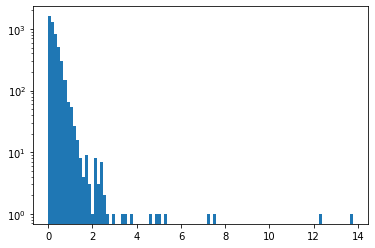

0.3076966410550946 0.4419991678740162


In [9]:
Zscore = np.array(metadata['_rlnparticleselectzscore'])
plt.hist(Zscore, bins=100, log=True)
plt.show()
print(np.mean(Zscore), np.std(Zscore))

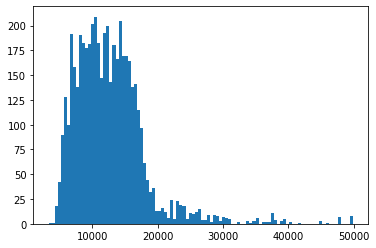

3333.739502 12692.950592391499 5603.567648669399


In [10]:
defocus = np.array(metadata['_rlndefocusu'])
plt.hist(defocus, bins=100, log=False)
plt.show()
print(np.min(defocus),np.mean(defocus), np.std(defocus))

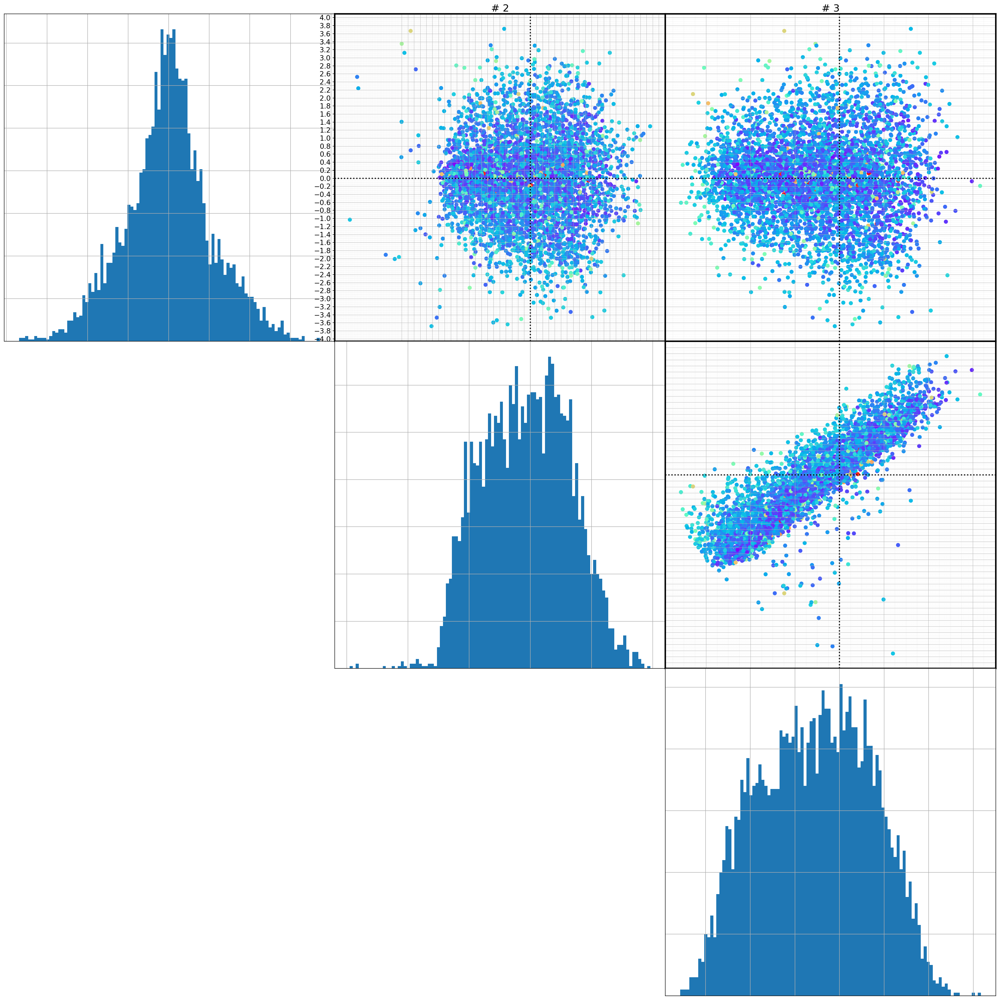

In [11]:
viz.biplots(mus, n=3, show_histo=True, nbins=100, c=metadata['_rlndefocusu'], 
            figname=KEYWORD+'/latent_space_defocus_true')

In [12]:
center = np.mean(mus,axis=0) #np.zeros(mus.shape) #
U, L, Vt = np.linalg.svd(mus - center, full_matrices=False)

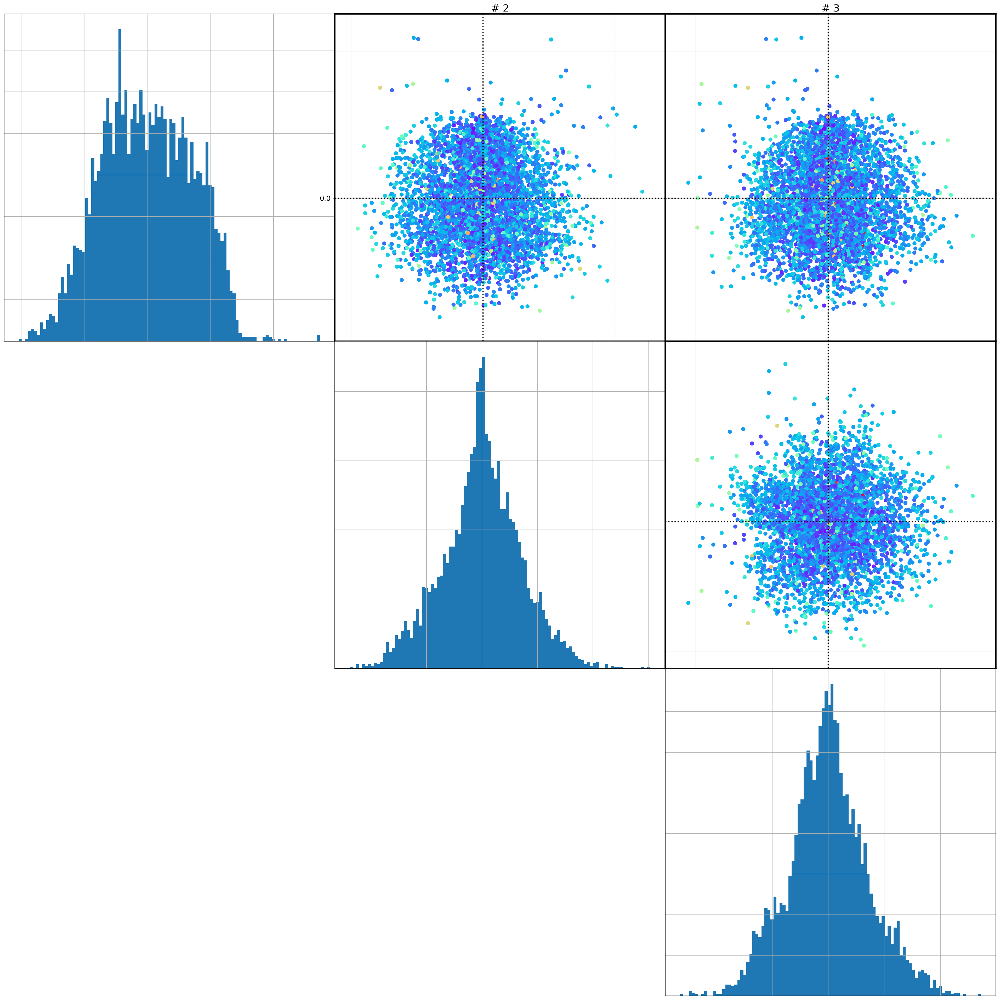

In [14]:
viz.biplots(U, n=3, show_histo=True, nbins=100, c=metadata['_rlndefocusu'], 
            figname=KEYWORD+'/latent_space_pca_defocus_true')

In [15]:
Zscore_set=2

In [16]:
positives = np.where(Zscore<Zscore_set)[0]
negatives = np.where(Zscore>Zscore_set)[0]
print(positives.shape,negatives.shape)

(4883,) (34,)


AUC(robust_covar) = 0.833678669092048
AUC(isolation_forest) = 0.8337991350543905
AUC(local_outlier_detection) = 0.8733782269819662


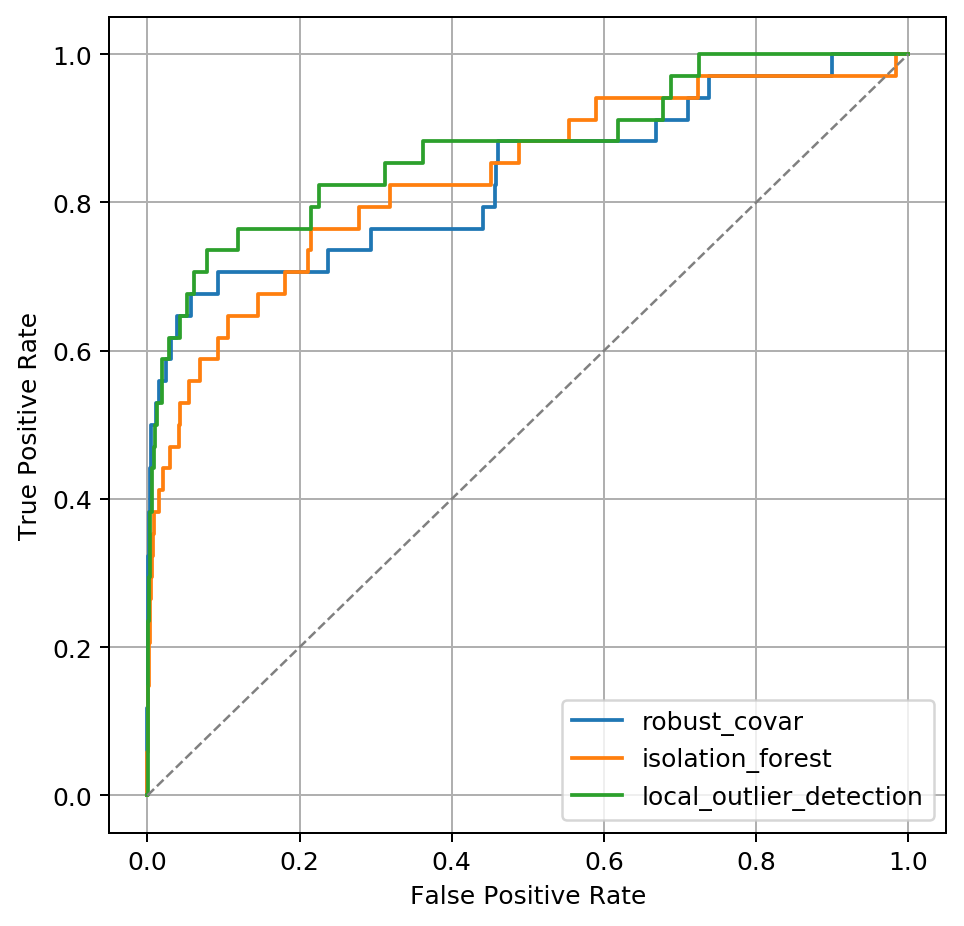

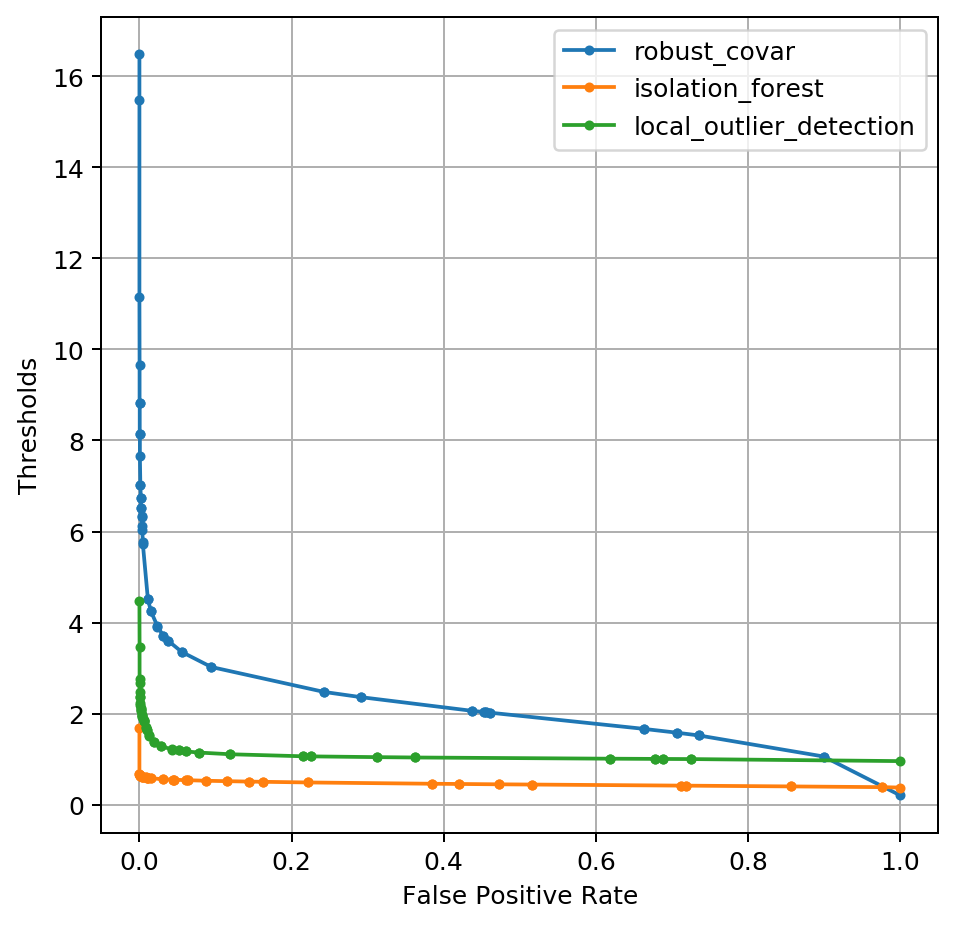

In [17]:
methods = ['robust_covar', 'isolation_forest', 'local_outlier_detection']
#
fig = plt.figure(figsize=(6,6), dpi=180)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
for method in methods:
    measure, offset, assignment = pred.outlier_measure(mus, method=method)
    fpr, tpr, thresholds = metrics.roc_curve(np.where(Zscore<Zscore_set,0,1), measure)
    plt.plot(fpr,tpr)
    print('AUC({}) = {}'.format(method, metrics.auc(fpr, tpr)))
plt.plot([0, 1], [0, 1], color='grey', lw=1, linestyle='--')
plt.legend(methods)
plt.grid()
fig.savefig(KEYWORD+'/ROC_Zscore'+str(Zscore_set))
#
fig = plt.figure(figsize=(6,6), dpi=180)
plt.xlabel('False Positive Rate')
plt.ylabel('Thresholds')
for method in methods:
    measure, offset, assignment = pred.outlier_measure(mus, method=method)
    fpr, tpr, thresholds = metrics.roc_curve(np.where(Zscore<Zscore_set,0,1), measure)
    plt.plot(fpr,thresholds, '.-')
    #print('AUC({}) = {}'.format(method, metrics.auc(fpr, tpr)))
#plt.plot([0, 1], [0, 1], color='grey', lw=1, linestyle='--')
plt.legend(methods)
plt.grid()
fig.savefig(KEYWORD+'/ROC_thresholds'+str(Zscore_set))

In [18]:
measure, offset, assignment = pred.outlier_measure(mus, method='robust_covar')

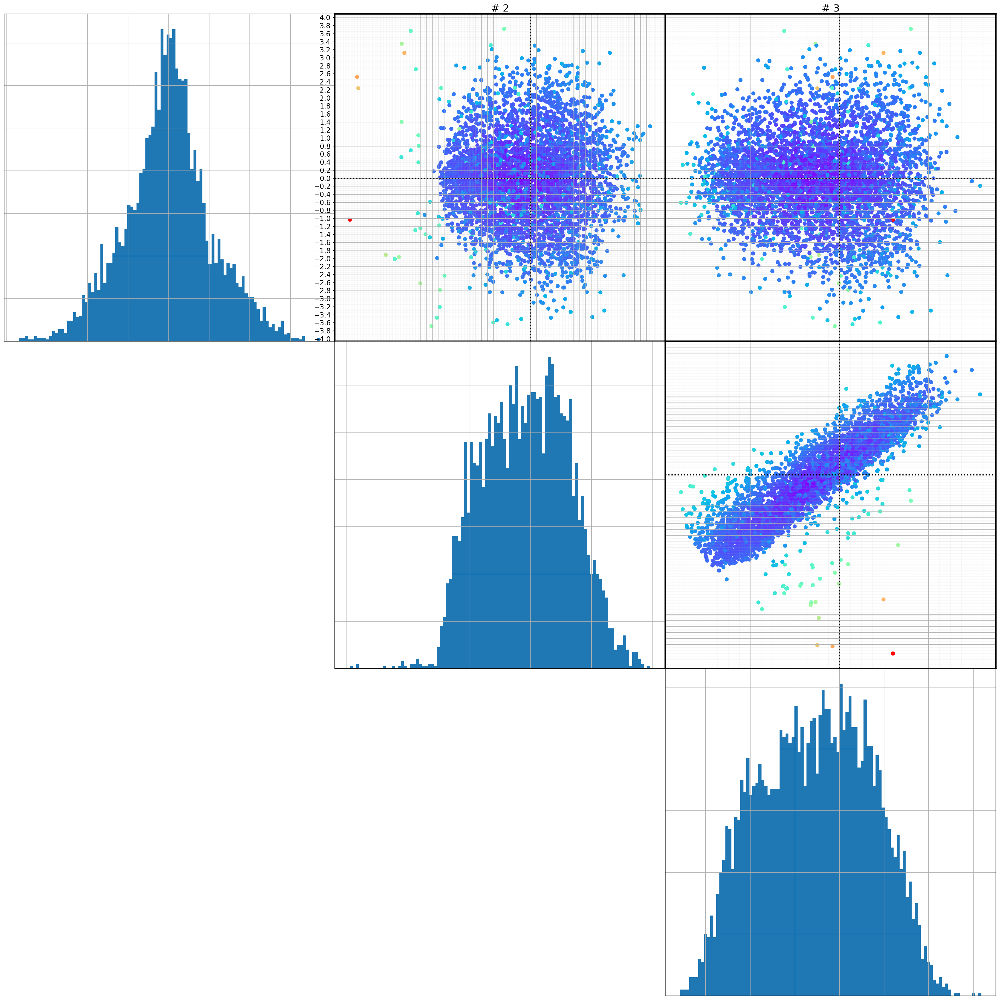

In [19]:
viz.biplots(mus, n=3, show_histo=True, nbins=100, c=measure, figname=KEYWORD+'/latent_space_robust_covar')

In [20]:
measure_threshold=5

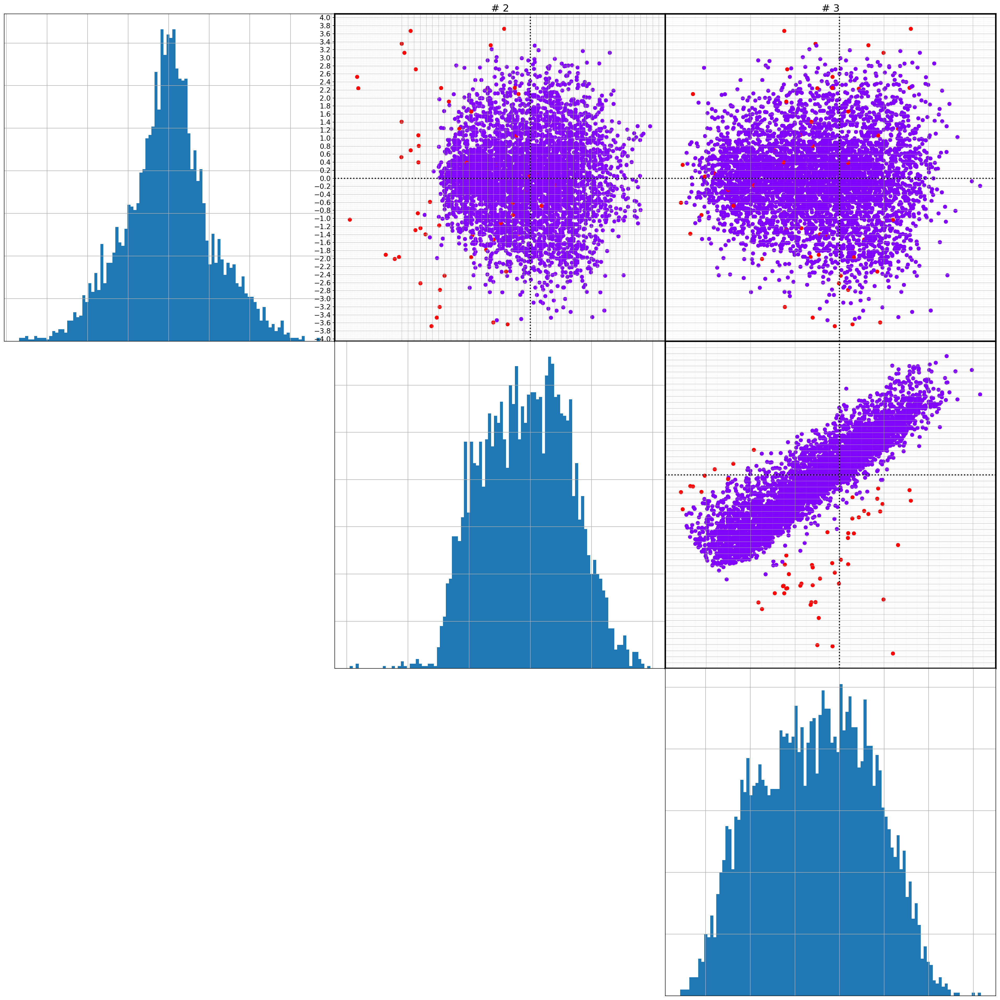

In [21]:
viz.biplots(mus, n=3, show_histo=True, nbins=100, c=np.where(measure<measure_threshold,0,1), figname=KEYWORD+'/latent_space_robust_covar_assigned')

In [22]:
mus_kept = mus[np.where(measure<measure_threshold),:][0,...]
print(mus_kept.shape)
defocus_kept = np.array(metadata['_rlndefocusu'])[np.where(measure<measure_threshold)]
print(defocus_kept.shape)
angle_kept = np.array(metadata['_rlnanglepsi'])[np.where(measure<measure_threshold)]
print(angle_kept.shape)
Zscore_kept = np.array(metadata['_rlnparticleselectzscore'])[np.where(measure<measure_threshold)]
print(Zscore_kept.shape)

(4861, 4)
(4861,)
(4861,)
(4861,)


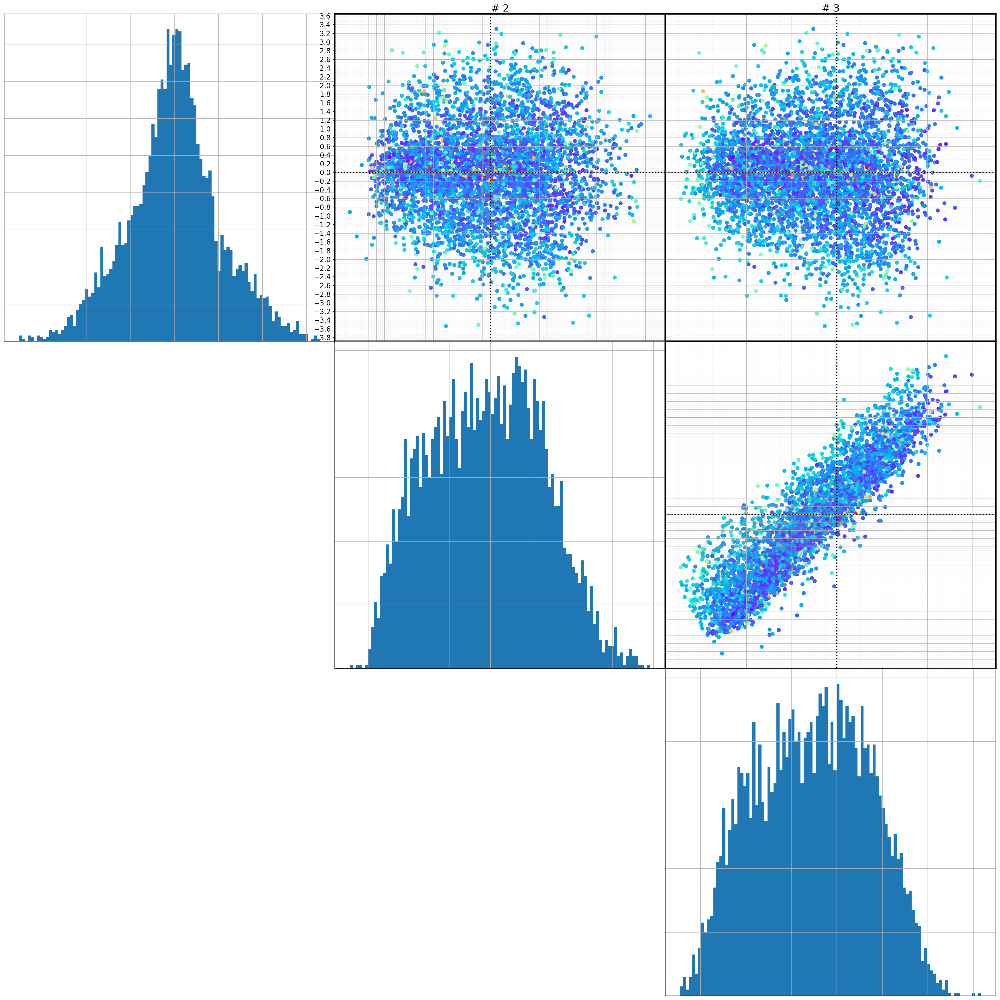

In [23]:
viz.biplots(mus_kept, n=3, show_histo=True, nbins=100, c=defocus_kept)

In [24]:
center = np.mean(mus_kept,axis=0) #np.zeros(mus_kept.shape) #
U, L, Vt = np.linalg.svd(mus_kept - center, full_matrices=False)

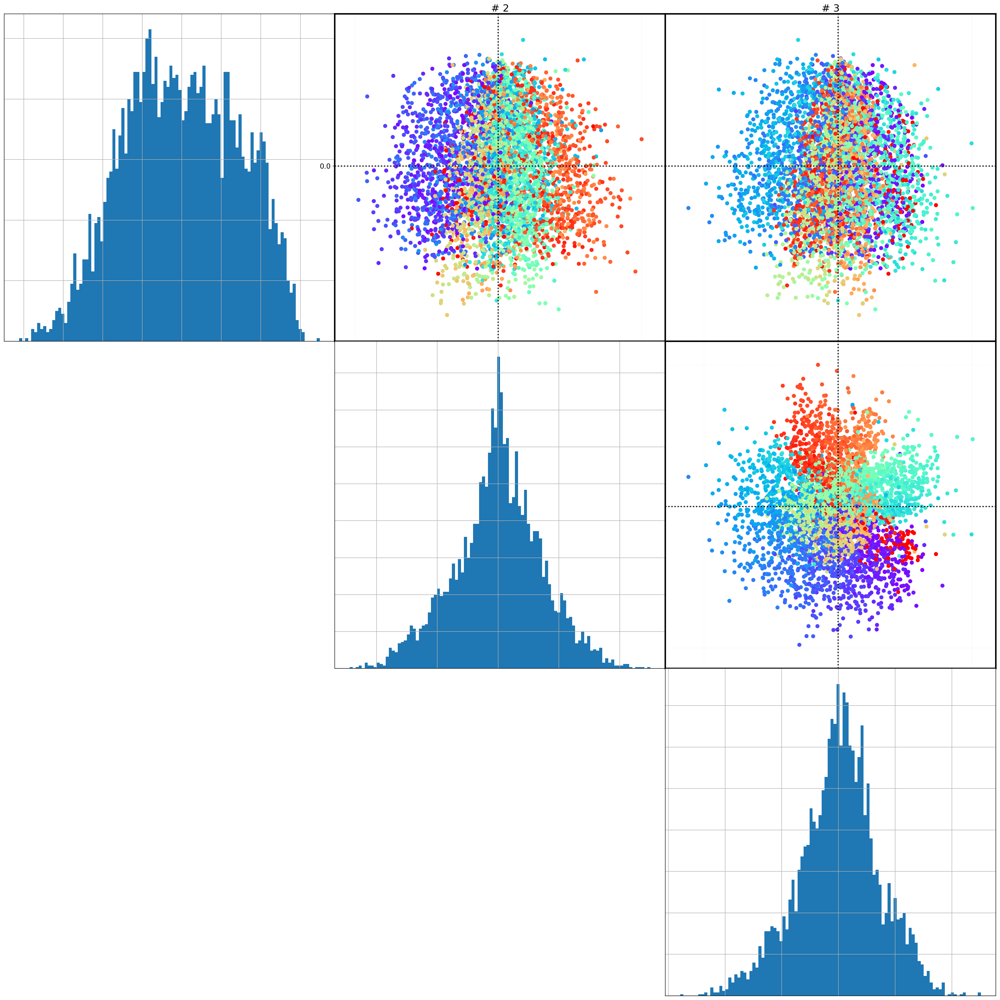

In [25]:
viz.biplots(U, n=3, show_histo=True, nbins=100, c=angle_kept)

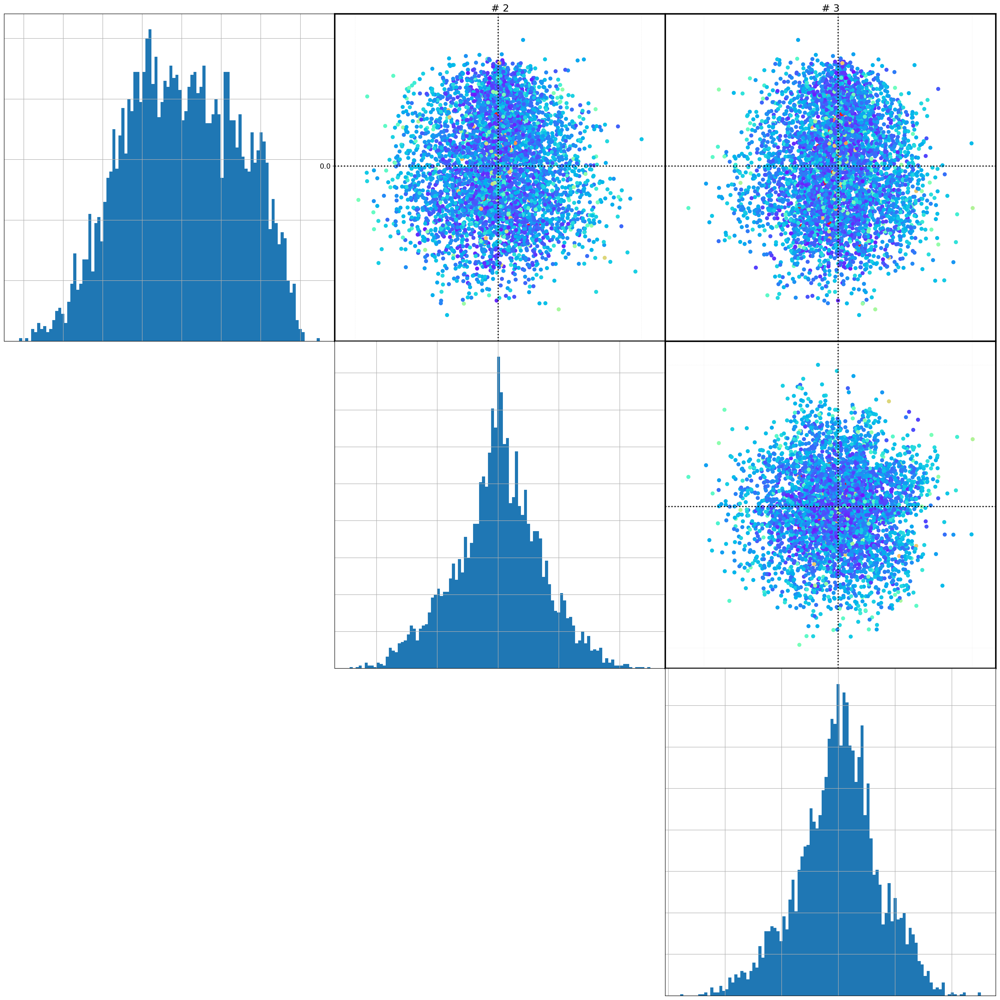

In [26]:
viz.biplots(U, n=3, show_histo=True, nbins=100, c=defocus_kept)

In [27]:
angle_true   = angle_kept + 180
defocus_true = defocus_kept

In [28]:
index = np.where((defocus_kept>5000)  & (defocus_kept < 25000))[0]

In [60]:
index.shape

(4659,)

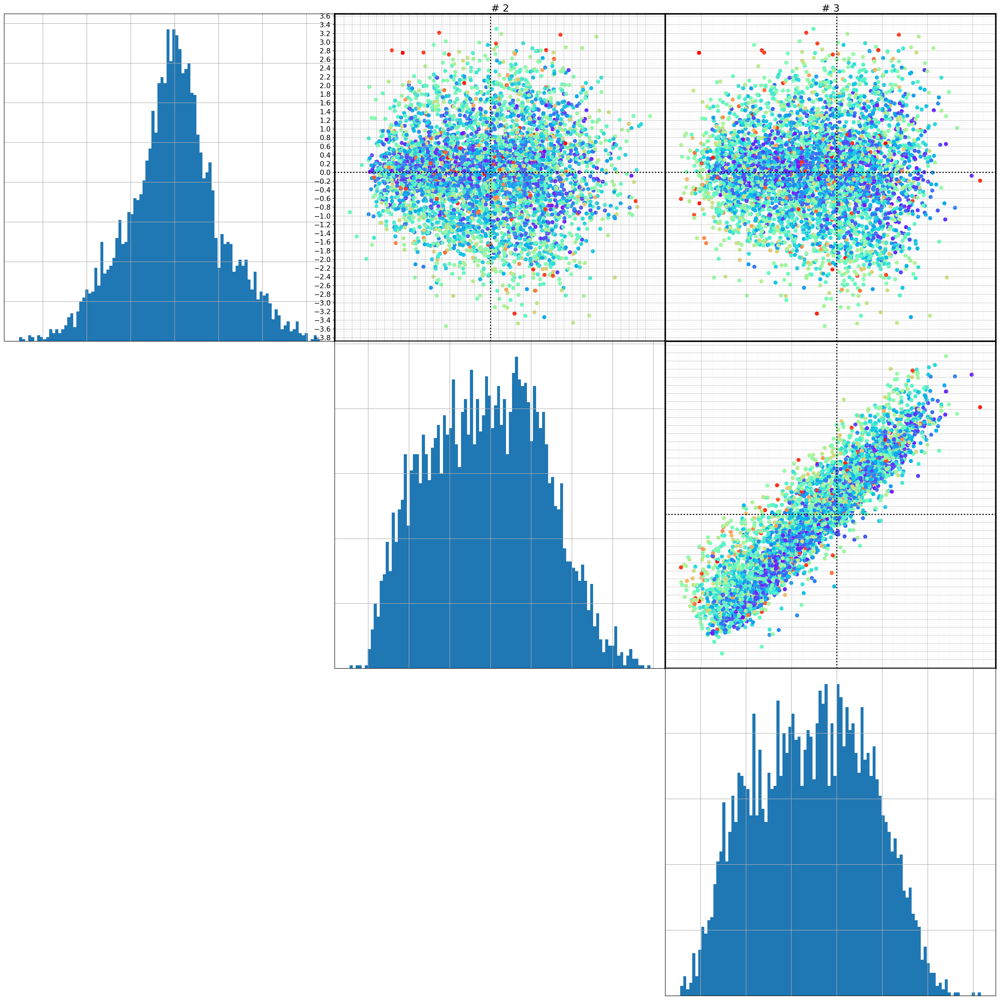

In [29]:
viz.biplots(mus_kept[index,:], n=3, show_histo=True, nbins=100, c=defocus_kept[index])

In [30]:
center = np.mean(mus_kept[index,:],axis=0) #np.zeros(mus_kept[index,:].shape) #
U_restricted, L_restricted, Vt_restricted = np.linalg.svd(mus_kept[index,:] - center, full_matrices=False)

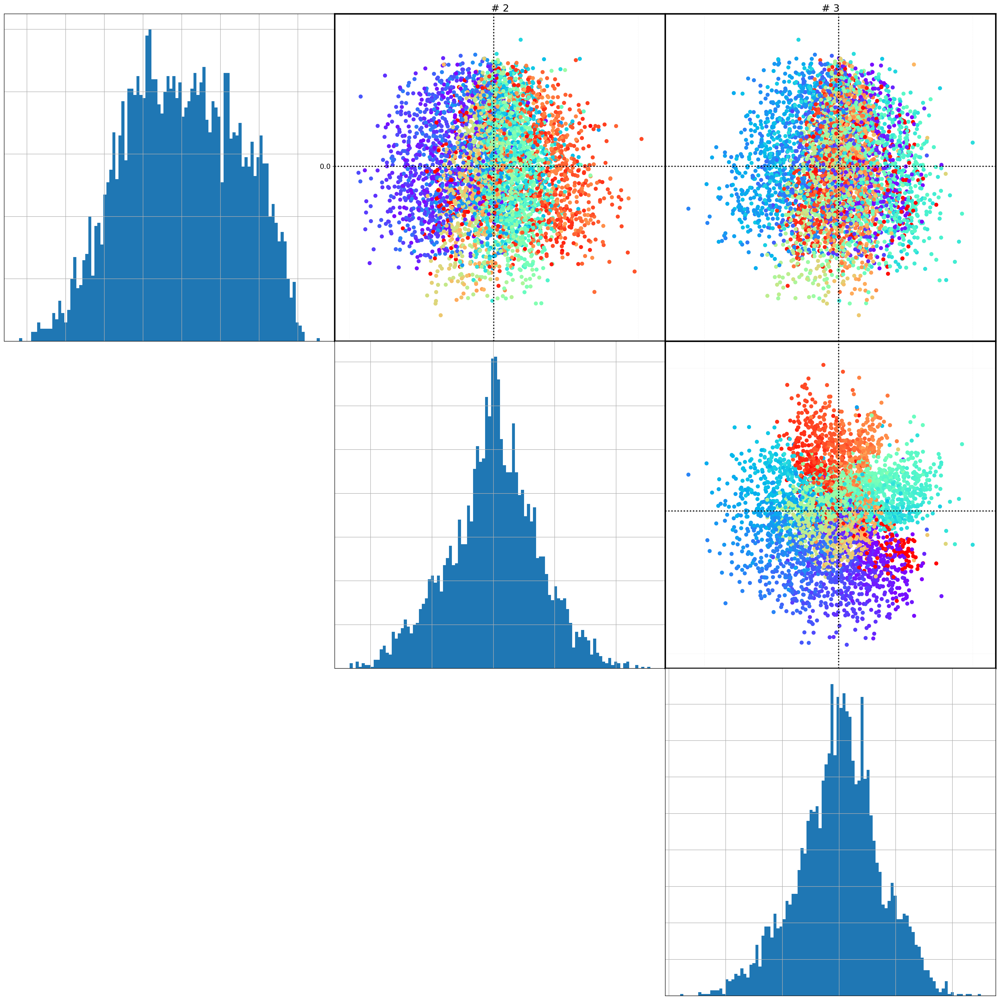

In [31]:
viz.biplots(U_restricted, n=3, show_histo=True, nbins=100, c=angle_kept[index])

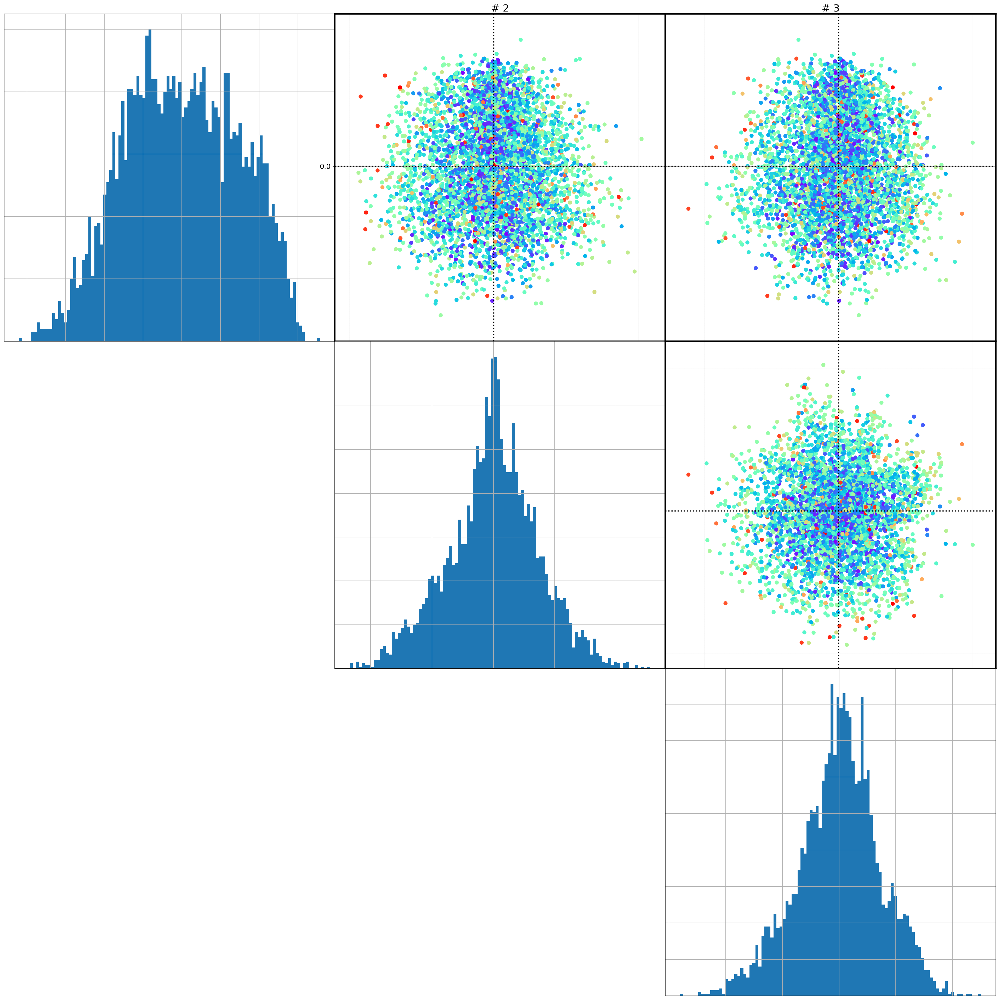

In [32]:
viz.biplots(U_restricted, n=3, show_histo=True, nbins=100, c=defocus_kept[index])

In [33]:
angle_restricted = angle_kept[index]
defocus_restricted = defocus_kept[index]

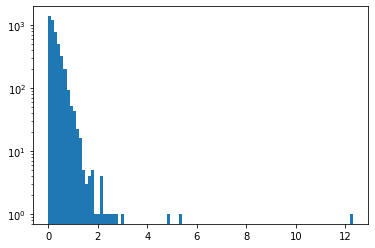

In [37]:
plt.hist(Zscore_kept[index], bins=100, log=True)
plt.show()

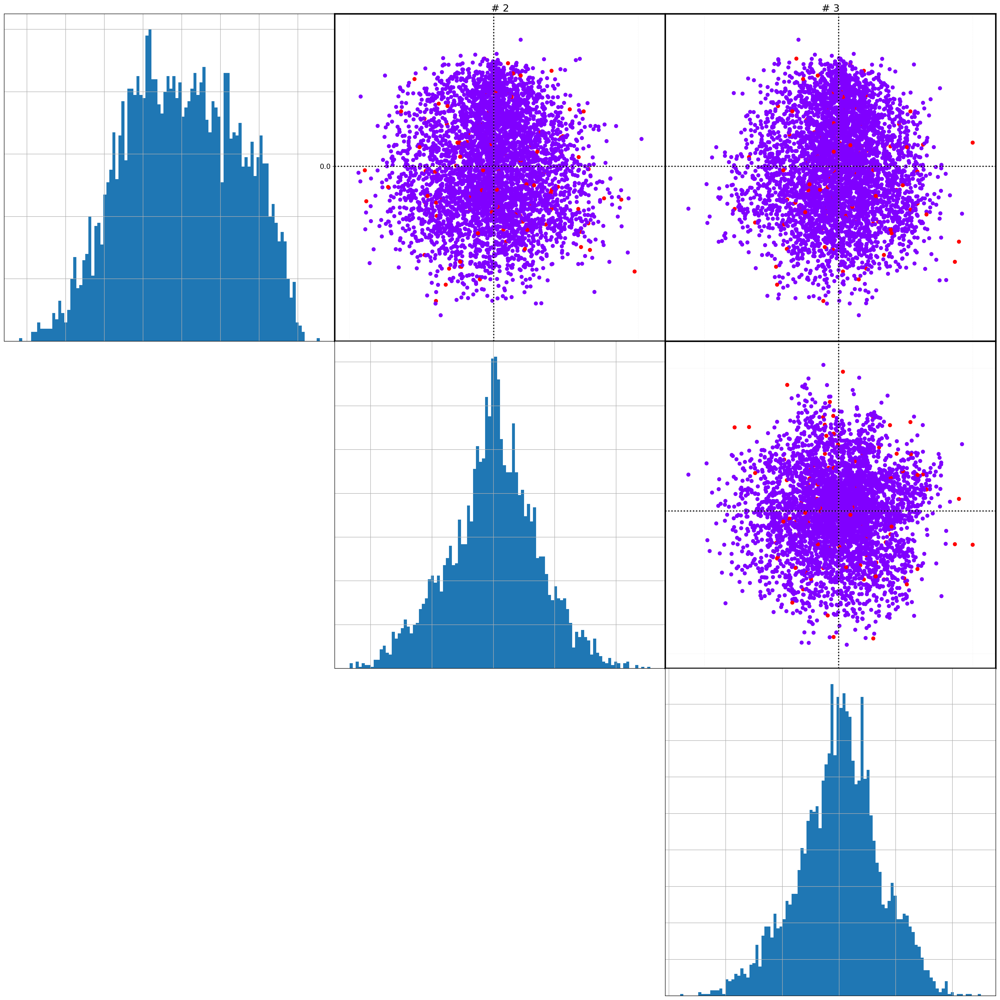

In [35]:
viz.biplots(U_restricted, n=3, show_histo=True, nbins=100, c=np.where(Zscore_kept[index]>1,1,0))

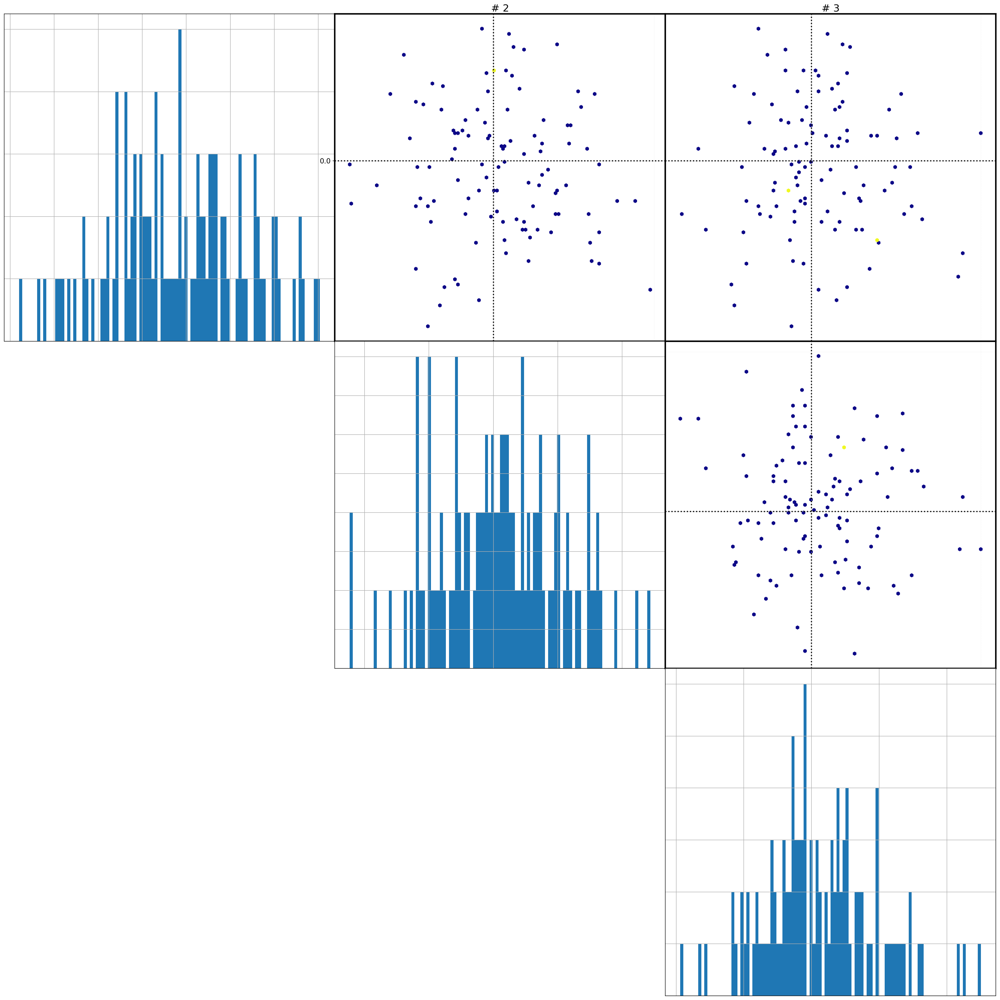

In [38]:
viz.biplots(U_restricted[np.where(Zscore_kept[index]>1)], n=3, show_histo=True, nbins=100)#, c=np.where(Zscore_kept[index]>1,1,0))

In [41]:
angle_pred, defocus_pred = pred.pred2d(U_restricted,  angle_true[index], defocus_true[index], 
                                       angle_pred_sign=1.0,
                                       defocus_min=5000,defocus_max=25000,
                                       do_ellipse=True)

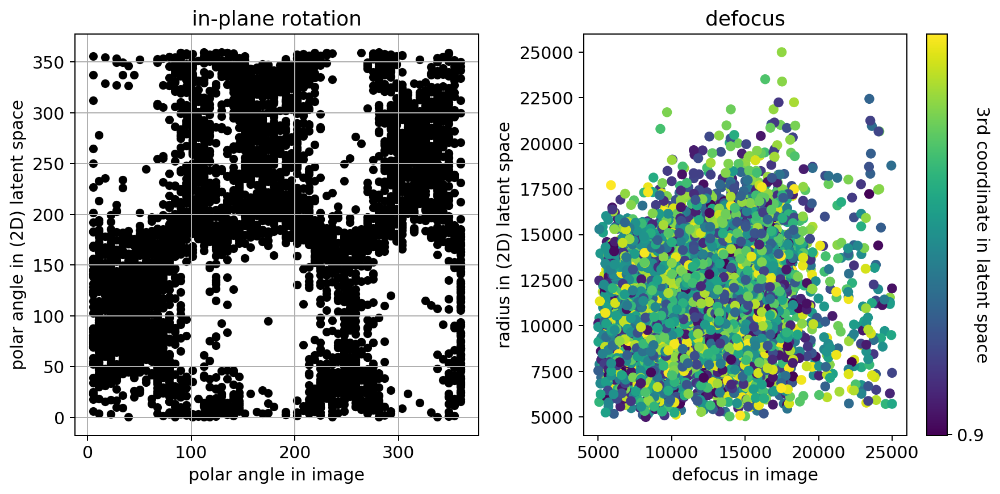

In [42]:
viz.plot_pred2d(angle_pred, defocus_pred, angle_true[index], defocus_true[index], metadata=angle_pred,
                figname=KEYWORD+'/polar_prediction_ellipse_rest')

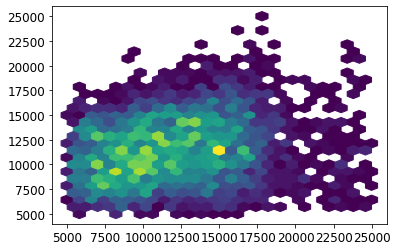

In [43]:
plt.hexbin(defocus_true[index],defocus_pred,gridsize=25,mincnt=1)

offset: -56 angle RMSE = 112.88823862633433
offset: -55 angle RMSE = 112.9235230515436
offset: -54 angle RMSE = 112.95570149473706
offset: -53 angle RMSE = 112.98214638826444
offset: -52 angle RMSE = 113.00212152983205
offset: -51 angle RMSE = 113.01724697386177
defocus RMSE = 4649.67157549504


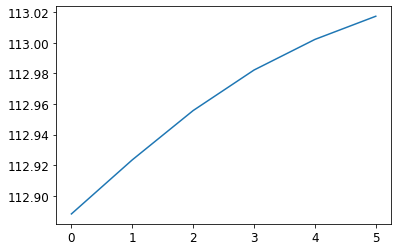

In [63]:
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true[index], defocus_true[index], 
                                                angle_offset_range=np.arange(-56,-50,1))
plt.plot(angle_RMSE_list)

### weight angle RMSE with defocus pred

In [45]:
angle_pred, defocus_pred = pred.pred2d(U_restricted,  angle_true[index], defocus_true[index], 
                                       angle_pred_sign=-1.0,
                                       defocus_min=5000,defocus_max=25000,
                                       do_ellipse=True)

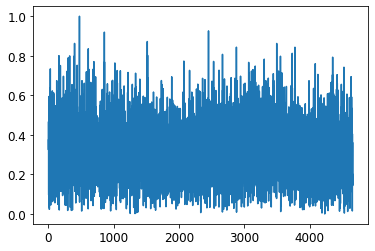

In [46]:
defocus_pred_normalized = pred.rescale_to_zero_one(defocus_pred)
plt.plot(defocus_pred_normalized)

offset: -208.0 angle RMSE = 94.35875491359849
offset: -207.75 angle RMSE = 94.35720155691563
offset: -207.5 angle RMSE = 94.35614715430721
offset: -207.25 angle RMSE = 94.3557156268319
offset: -207.0 angle RMSE = 94.35557651757026
offset: -206.75 angle RMSE = 94.35597978267587
offset: -206.5 angle RMSE = 94.3569606973967
offset: -206.25 angle RMSE = 94.35829710869504
defocus RMSE = 4649.67157549504


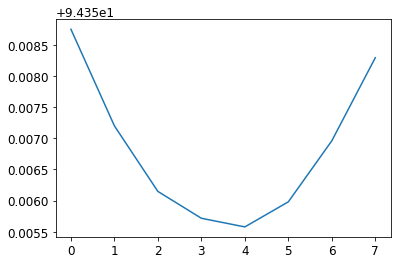

In [64]:
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true[index], defocus_true[index], 
                                                angle_offset_range=np.arange(-208,-206,0.25),
                                                angle_weight=None, norm_weights=True)
plt.plot(angle_RMSE_list)

offset: -195.0 angle RMSE = 89.17696261851992
offset: -194.75 angle RMSE = 89.17259682197466
offset: -194.5 angle RMSE = 89.16876235388638
offset: -194.25 angle RMSE = 89.16561148616053
offset: -194.0 angle RMSE = 89.16281889830398
offset: -193.75 angle RMSE = 89.16022362388398
offset: -193.5 angle RMSE = 89.15821145438343
offset: -193.25 angle RMSE = 89.15666410755637
offset: -193.0 angle RMSE = 89.15565806303938
offset: -192.75 angle RMSE = 89.15535303544812
offset: -192.5 angle RMSE = 89.15570572151721
offset: -192.25 angle RMSE = 89.15655825686407
offset: -192.0 angle RMSE = 89.15796097786655
offset: -191.75 angle RMSE = 89.15999966576514
offset: -191.5 angle RMSE = 89.16239030520609
offset: -191.25 angle RMSE = 89.16535545081751
offset: -191.0 angle RMSE = 89.16860709415981
offset: -190.75 angle RMSE = 89.17205906876512
offset: -190.5 angle RMSE = 89.17553203944452
offset: -190.25 angle RMSE = 89.1790848892607
defocus RMSE = 4649.67157549504


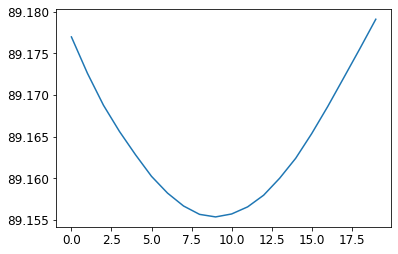

In [54]:
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true[index], defocus_true[index], 
                                                angle_offset_range=np.arange(-195,-190,0.25),
                                                angle_weight=(np.exp(defocus_pred_normalized)-1), norm_weights=True)
plt.plot(angle_RMSE_list)

offset: -210 angle RMSE = 94.53707805602703
offset: -209 angle RMSE = 94.5190275522607
offset: -208 angle RMSE = 94.50411311964743
offset: -207 angle RMSE = 94.4949774165743
offset: -206 angle RMSE = 94.49321019041751
offset: -205 angle RMSE = 94.49605247709574
offset: -204 angle RMSE = 94.5037406274909
offset: -203 angle RMSE = 94.51804116344644
offset: -202 angle RMSE = 94.53800881182535
offset: -201 angle RMSE = 94.56114506817835
defocus RMSE = 4649.67157549504


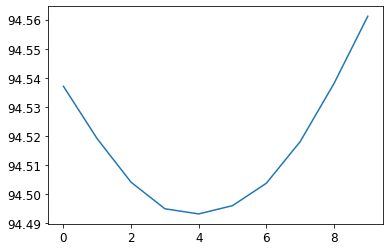

In [59]:
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true[index], defocus_true[index], 
                                                angle_offset_range=np.arange(-210,-200,1),
                                                angle_weight=np.exp(-np.abs(Zscore[index])), norm_weights=True)
plt.plot(angle_RMSE_list)

### Remove central disk

In [27]:
U_norm = np.linalg.norm(U_restricted[:,0:2], axis=1)
index_shell = U_norm>np.max(U_norm)/20
print(len(index_shell))
U_shell = U_restricted[index_shell]

4798


In [28]:
U_norm.shape

(4798,)

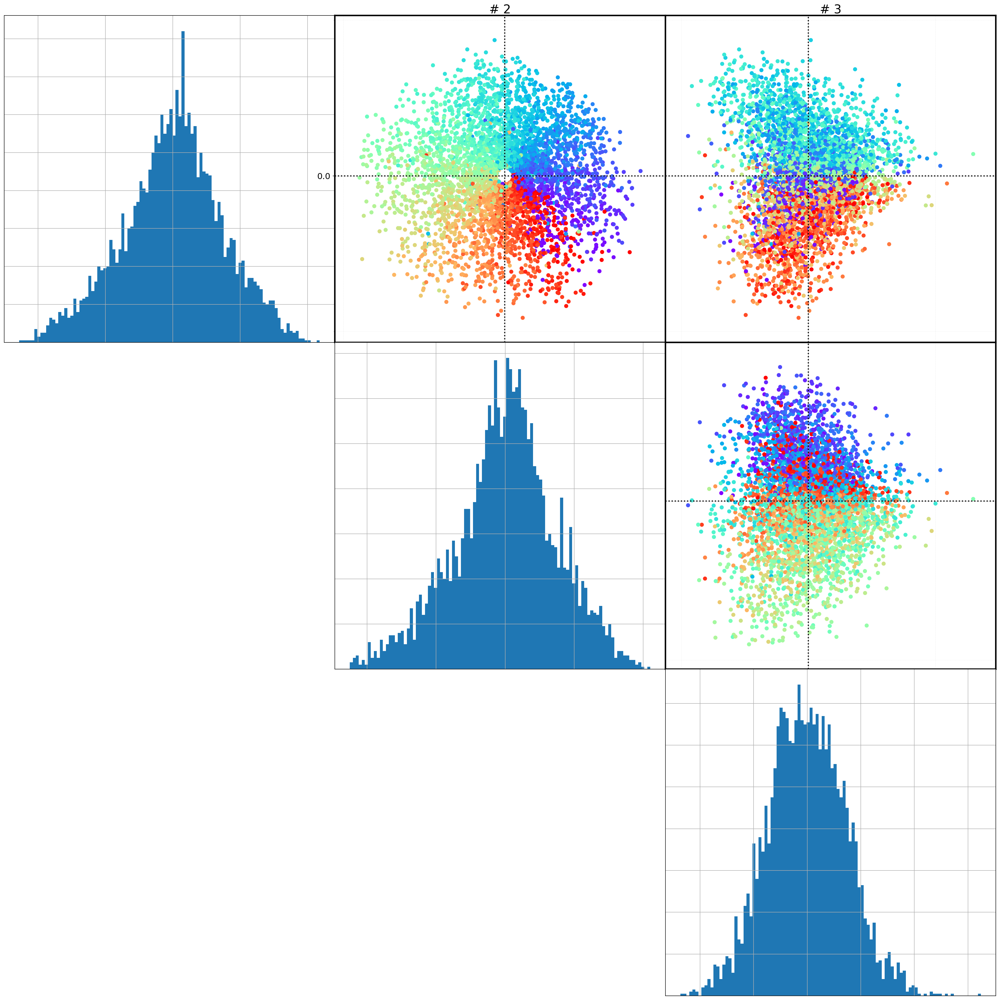

In [47]:
viz.biplots(U_shell, n=3, show_histo=True, nbins=100, c=angle_restricted[index_shell])

In [29]:
angle_pred, defocus_pred = pred.pred2d(U_shell,  angle_restricted[index_shell], defocus_restricted[index_shell], 
                                       angle_pred_sign=-1.0,
                                       defocus_min=5000,defocus_max=25000,
                                       do_ellipse=True)

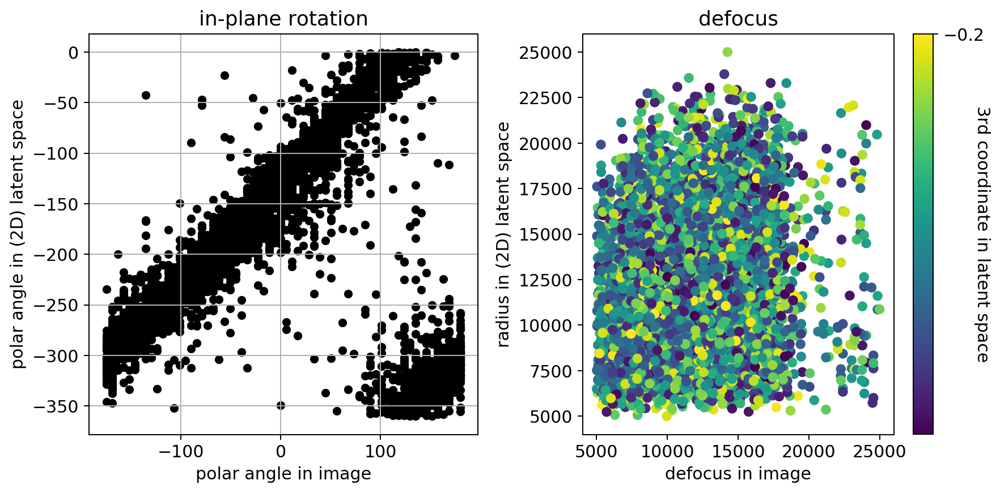

In [30]:
viz.plot_pred2d(angle_pred, defocus_pred, angle_restricted[index_shell], defocus_restricted[index_shell], metadata=angle_pred,
                figname=KEYWORD+'/polar_prediction_ellipse_rest')

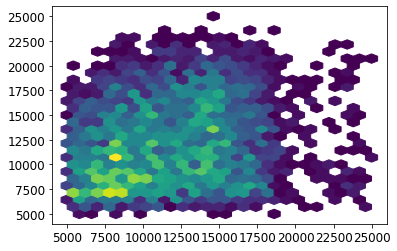

In [52]:
plt.hexbin(defocus_restricted[index_shell],defocus_pred,gridsize=25,mincnt=1)

offset: -240 angle RMSE = 28.478750750355285
offset: -238 angle RMSE = 28.024663586721417
offset: -236 angle RMSE = 27.699471078347457
offset: -234 angle RMSE = 27.513674109826297
offset: -232 angle RMSE = 27.4676738878472
offset: -230 angle RMSE = 27.566300883942226
offset: -228 angle RMSE = 27.808789683632657
offset: -226 angle RMSE = 28.19142817461563
offset: -224 angle RMSE = 28.708613020258174
offset: -222 angle RMSE = 29.353233235872278
defocus RMSE = 5280.114250164366


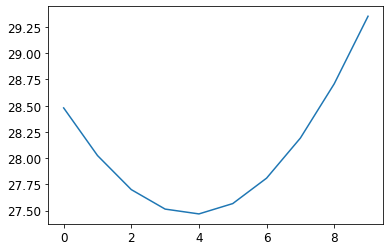

In [56]:
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_restricted[index_shell], defocus_restricted[index_shell], 
                                                angle_offset_range=np.arange(-240,-220,2))
plt.plot(angle_RMSE_list)